<a href="https://colab.research.google.com/github/lkatib/Demo/blob/main/Palestine_Israel_Sentiment_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Sentiment Analysis of Reddit Comments on Israel and Palestine Conflict: A Social Discourse Study

![ip%201.jpg](attachment:ip%201.jpg)

In [ ]:
# An Machine Learning project by: Prof. Nirmal Gaud
# Contact: ds.ml.projects.sessions.1@gmail.com

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv('pls_isl_conflict_comments.csv')

In [ ]:
df.head()

,comment_id,score,self_text,subreddit,created_time
0,k5480sx,1,Exactly! I can remember the humanitarian aid s...,worldnews,16-10-2023 19:39
1,k547q14,1,*We are the only part of the World that has Fr...,Palestine,16-10-2023 19:36
2,k547elf,1,"I don’t make Israeli strategy, nor am I Israel...",worldnews,16-10-2023 19:34
3,k54742r,1,These people didn't vote Hamas in or something...,worldnews,16-10-2023 19:32
4,k5473zi,1,We don't care what you do. We just want to liv...,worldnews,16-10-2023 19:32


In [ ]:
df.tail()

,comment_id,score,self_text,subreddit,created_time
189626,k3sdwfc,42,US. This is bullshit,Palestine,07-10-2023 05:20
189627,k3sdixt,1,I am in the United States and it has the dotte...,Palestine,07-10-2023 05:17
189628,k3sccp2,54,In which country are you?\nSometimes maps adap...,Palestine,07-10-2023 05:08
189629,k3ritvj,116,You can't give up on something you only preten...,worldnews,07-10-2023 01:46
189630,k3riboh,30,&gt; The head of Islamic Jihad denounced Arab ...,worldnews,07-10-2023 01:42


In [ ]:
df.shape

(189631, 5)

In [ ]:
df.columns

Index(['comment_id', 'score', 'self_text', 'subreddit', 'created_time'], dtype='object')

In [ ]:
df.duplicated().sum()

0

In [ ]:
df.isnull().sum()

comment_id      0
score           0
self_text       0
subreddit       0
created_time    0
dtype: int64

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189631 entries, 0 to 189630
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   comment_id    189631 non-null  object
 1   score         189631 non-null  int64 
 2   self_text     189631 non-null  object
 3   subreddit     189631 non-null  object
 4   created_time  189631 non-null  object
dtypes: int64(1), object(4)
memory usage: 7.2+ MB


In [ ]:
df.describe()

,score
count,189631.000000
mean,28.583607
std,179.946085
min,-934.000000
25%,1.000000
50%,2.000000
75%,10.000000
max,16463.000000


In [ ]:
df.nunique()

comment_id      189631
score             1761
self_text       186338
subreddit           14
created_time     13562
dtype: int64

In [ ]:
object_columns = df.select_dtypes(include=['object']).columns
print("Object type columns:")
print(object_columns)

numerical_columns = df.select_dtypes(include=['int', 'float']).columns
print("\nNumerical type columns:")
print(numerical_columns)

Object type columns:
Index(['comment_id', 'self_text', 'subreddit', 'created_time'], dtype='object')

Numerical type columns:
Index(['score'], dtype='object')


In [ ]:
df['subreddit'].unique()

array(['worldnews', 'Palestine', 'IsraelPalestine', 'TerrifyingAsFuck',
       'worldnewsvideo', 'AskMiddleEast', 'CombatFootage',
       'PublicFreakout', 'NonCredibleDefense', 'IsrealPalestineWar_23',
       'CrazyFuckingVideos', 'AbruptChaos', 'NoahGetTheBoat',
       'ActualPublicFreakouts'], dtype=object)

In [ ]:
df['subreddit'].value_counts()

IsraelPalestine          52622
worldnews                36204
AskMiddleEast            28107
CombatFootage            27901
PublicFreakout           14255
NonCredibleDefense       13865
Palestine                 6968
worldnewsvideo            5598
IsrealPalestineWar_23     2537
TerrifyingAsFuck           546
NoahGetTheBoat             498
AbruptChaos                200
CrazyFuckingVideos         197
ActualPublicFreakouts      133
Name: subreddit, dtype: int64

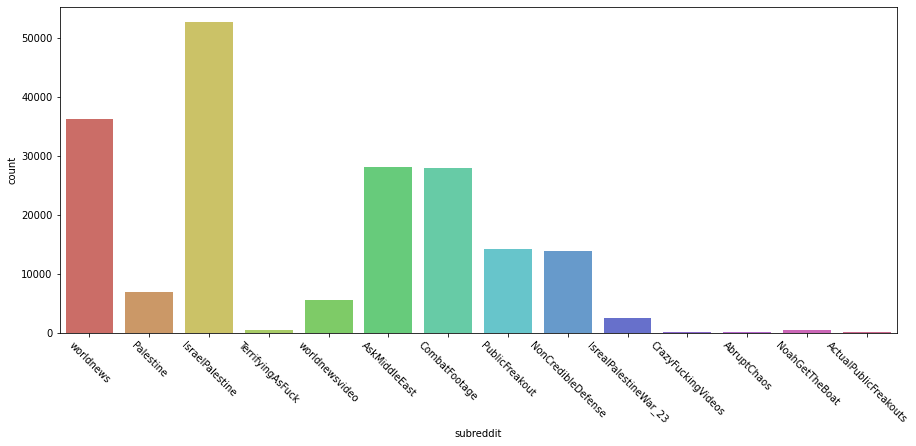

In [ ]:
plt.figure(figsize=(15,6))
sns.countplot(df['subreddit'], data = df, palette = 'hls')
plt.xticks(rotation = -45)
plt.show()

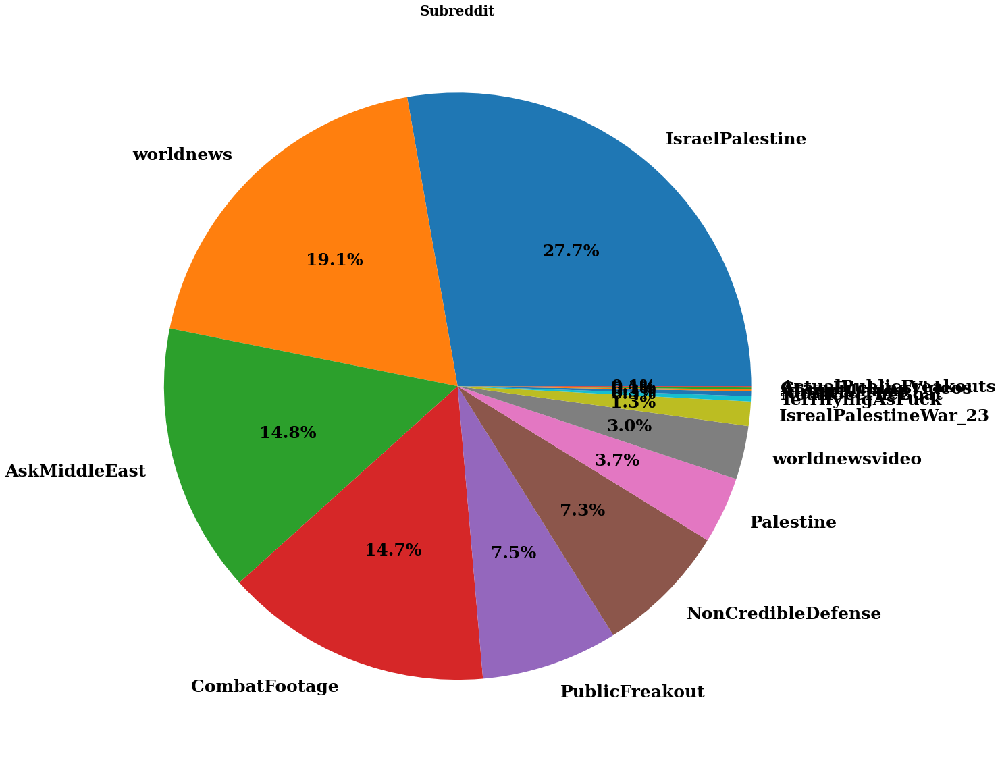

In [ ]:
plt.figure(figsize=(30,20))
plt.pie(df['subreddit'].value_counts(), labels=df['subreddit'].value_counts().index,
        autopct='%1.1f%%', textprops={ 'fontsize': 25,
                                       'color': 'black',
                                        'weight': 'bold',
                                        'family': 'serif' })
hfont = {'fontname':'serif', 'weight': 'bold'}
plt.title('Subreddit', size=20, **hfont)
plt.show()

In [ ]:
fig = go.Figure(data=[go.Bar(x=df['subreddit'].value_counts().index,
                                 y=df['subreddit'].value_counts())])
fig.update_layout(title='Subreddit', xaxis_title='Subreddit', yaxis_title="Count")
fig.show()

In [ ]:
fig = px.pie(df, names='subreddit', title = 'Subreddit')
fig.show()

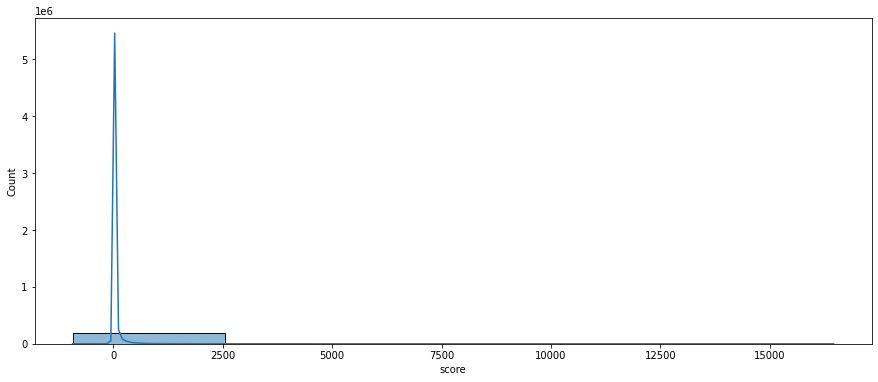

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(df['score'], kde = True, bins = 5, palette = 'hls')
plt.show()

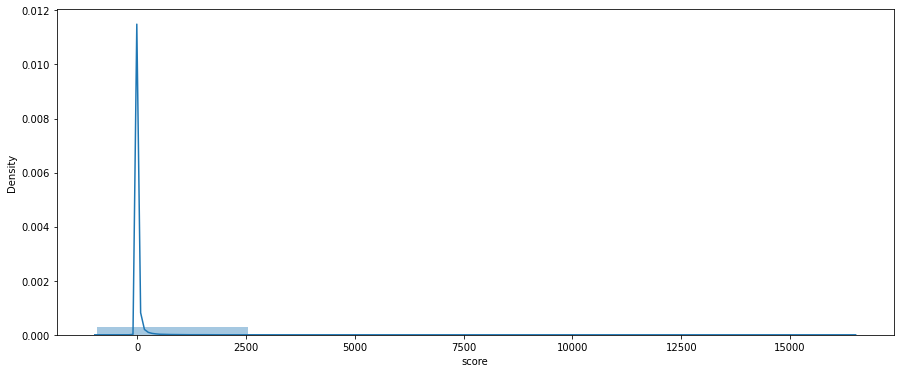

In [ ]:
plt.figure(figsize=(15,6))
sns.distplot(df['score'], kde = True, bins = 5)
plt.show()

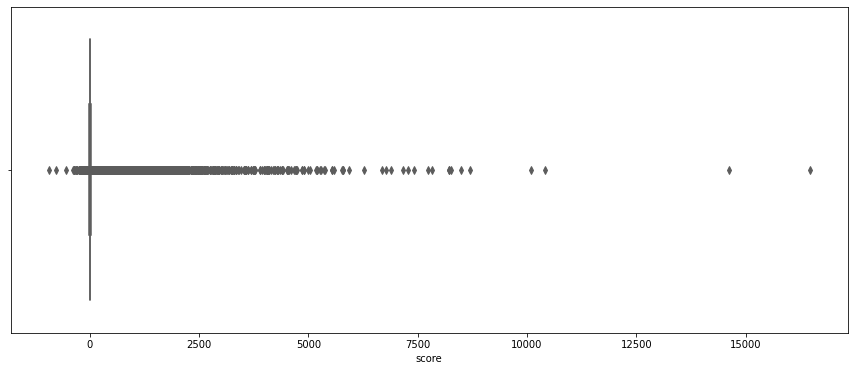

In [ ]:
plt.figure(figsize=(15,6))
sns.boxplot(df['score'], data = df, palette = 'hls')
plt.show()

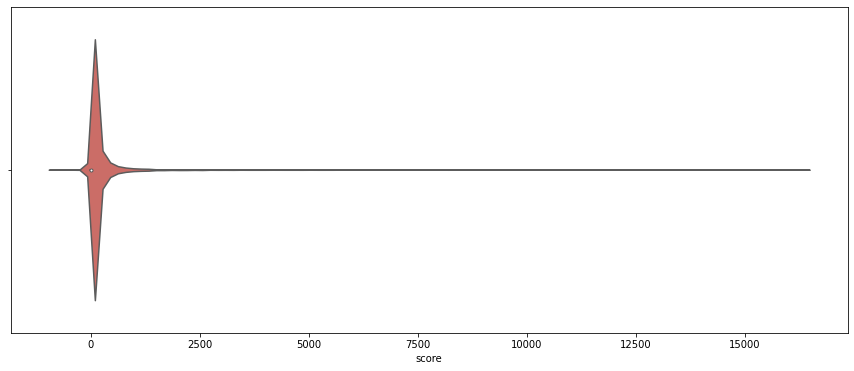

In [ ]:
plt.figure(figsize=(15,6))
sns.violinplot(df['score'], data = df, palette = 'hls')
plt.show()

In [ ]:
fig = go.Figure(data=[go.Histogram(x=df['score'], nbinsx=5)])
fig.update_layout(title='Histogram of score', xaxis_title='score', yaxis_title='Count')
fig.show()

In [ ]:
fig = px.box(df, y='score', title=f'Box Plot Score')
fig.show()

In [ ]:
fig = px.violin(df, y='score', title=f'Box Plot Score')
fig.show()

In [ ]:
df_new = df.copy()

In [ ]:
def clean_text(text):
    text = text.lower()
    return text.strip()

In [ ]:
df_new['self_text'] = df_new['self_text'].apply(lambda x: clean_text(x))

In [ ]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def remove_punctuation(text):
    punctuationfree="".join([i for i in text if i not in string.punctuation])
    return punctuationfree

In [ ]:
df_new['self_text']= df_new['self_text'].apply(lambda x:remove_punctuation(x))

In [ ]:
import re

In [ ]:
def tokenization(text):
    tokens = re.split('W+',text)
    return tokens

In [ ]:
df_new['self_text']= df_new['self_text'].apply(lambda x: tokenization(x))

In [ ]:
import nltk
from wordcloud import WordCloud

In [ ]:
nltk.download('vader_lexicon')
nltk.download('stopwords')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\hp5cd\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\hp5cd\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
stopwords = nltk.corpus.stopwords.words('english')

In [ ]:
def remove_stopwords(text):
    output= " ".join(i for i in text if i not in stopwords)
    return output

In [ ]:
df_new['self_text']= df_new['self_text'].apply(lambda x:remove_stopwords(x))

In [ ]:
from nltk.stem import WordNetLemmatizer

In [ ]:
wordnet_lemmatizer = WordNetLemmatizer()

In [ ]:
def lemmatizer(text):
    lemm_text = "".join([wordnet_lemmatizer.lemmatize(word) for word in text])
    return lemm_text

In [ ]:
df_new['self_text']=df_new['self_text'].apply(lambda x:lemmatizer(x))

In [ ]:
def clean_text(text):
    text = re.sub('\[.*\]','', text).strip()
    text = re.sub('\S*\d\S*\s*','', text).strip()
    return text.strip()

In [ ]:
df_new['self_text'] = df_new['self_text'].apply(lambda x: clean_text(x))

In [ ]:
def remove_urls(vTEXT):
    vTEXT = re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE)
    return(vTEXT)

In [ ]:
df_new['self_text'] = df_new['self_text'].apply(lambda x: remove_urls(x))

In [ ]:
def remove_digits(text):
    clean_text = re.sub(r"\b[0-9]+\b\s*", "", text)
    return(text)

In [ ]:
df_new['self_text'] = df_new['self_text'].apply(lambda x: remove_digits(x))

In [ ]:
def remove_emojis(data):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"  # emoticons
                               u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                               u"\U0001F680-\U0001F6FF"  # transport & map symbols
                               u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                               "]+", flags=re.UNICODE)
    return re.sub(emoji_pattern, '', data)

In [ ]:
df_new['self_text'] = df_new['self_text'].apply(lambda x: remove_emojis(x))

In [ ]:
df_new['self_text'] = df_new['self_text'].apply(lambda x:re.sub(r'\s+[a-zA-Z]\s+', '', x))

In [ ]:
df_new['self_text'] = df_new['self_text'].apply(lambda x:re.sub(r'\s+', ' ', x, flags=re.I))

In [ ]:
df_new

,comment_id,score,self_text,subreddit,created_time
0,k5480sx,1,exactlycan remember the humanitarian aid strea...,worldnews,16-10-2023 19:39
1,k547q14,1,we are the only part of the world that has fre...,Palestine,16-10-2023 19:36
2,k547elf,1,i don’t make israeli strategy nor amisraeli or...,worldnews,16-10-2023 19:34
3,k54742r,1,these people didnt vote hamas in or something ...,worldnews,16-10-2023 19:32
4,k5473zi,1,we dont care what you do we just want to live ...,worldnews,16-10-2023 19:32
...,...,...,...,...,...
189626,k3sdwfc,42,us this is bullshit,Palestine,07-10-2023 05:20
189627,k3sdixt,1,i am in the united states and it has the dotte...,Palestine,07-10-2023 05:17
189628,k3sccp2,54,in which country are you sometimes maps adapt ...,Palestine,07-10-2023 05:08
189629,k3ritvj,116,you cant give up on something you only pretend...,worldnews,07-10-2023 01:46


In [ ]:
from textblob import TextBlob

In [ ]:
df_new['sentiment'] = df_new['self_text'].apply(lambda x: TextBlob(str(x)).sentiment.polarity)

In [ ]:
df_new

,comment_id,score,self_text,subreddit,created_time,sentiment
0,k5480sx,1,exactlycan remember the humanitarian aid strea...,worldnews,16-10-2023 19:39,0.000000
1,k547q14,1,we are the only part of the world that has fre...,Palestine,16-10-2023 19:36,0.000000
2,k547elf,1,i don’t make israeli strategy nor amisraeli or...,worldnews,16-10-2023 19:34,0.305159
3,k54742r,1,these people didnt vote hamas in or something ...,worldnews,16-10-2023 19:32,0.045000
4,k5473zi,1,we dont care what you do we just want to live ...,worldnews,16-10-2023 19:32,-0.347643
...,...,...,...,...,...,...
189626,k3sdwfc,42,us this is bullshit,Palestine,07-10-2023 05:20,0.000000
189627,k3sdixt,1,i am in the united states and it has the dotte...,Palestine,07-10-2023 05:17,0.000000
189628,k3sccp2,54,in which country are you sometimes maps adapt ...,Palestine,07-10-2023 05:08,0.000000
189629,k3ritvj,116,you cant give up on something you only pretend...,worldnews,07-10-2023 01:46,-0.300000


In [ ]:
sentiment_correlation = df_new[['score', 'sentiment']].corr()
print('Correlation between "score" and sentiment:')
print(sentiment_correlation)

Correlation between "score" and sentiment:
             score  sentiment
score      1.00000   -0.00933
sentiment -0.00933    1.00000


In [ ]:
average_score_per_subreddit = df_new.groupby('subreddit')['score'].mean()
print('Average score per subreddit:')
print(average_score_per_subreddit)

Average score per subreddit:
subreddit
AbruptChaos               8.715000
ActualPublicFreakouts    60.563910
AskMiddleEast             4.736400
CombatFootage            40.808430
CrazyFuckingVideos       11.223350
IsraelPalestine           1.436205
IsrealPalestineWar_23     1.746945
NoahGetTheBoat           12.160643
NonCredibleDefense       33.659719
Palestine                11.412600
PublicFreakout           47.413750
TerrifyingAsFuck         36.661172
worldnews                76.210336
worldnewsvideo            8.808324
Name: score, dtype: float64


In [ ]:
df_new['created_time'] = pd.to_datetime(df_new['created_time'])

In [ ]:
score_over_time = df_new.set_index('created_time').resample('D')['score'].mean()
print('Score trends over time:')
print(score_over_time)

Score trends over time:
created_time
2023-07-10    120.231962
2023-07-11           NaN
2023-07-12           NaN
2023-07-13           NaN
2023-07-14           NaN
                 ...    
2023-12-06           NaN
2023-12-07           NaN
2023-12-08           NaN
2023-12-09           NaN
2023-12-10     28.593894
Freq: D, Name: score, Length: 154, dtype: float64


In [ ]:
df_new['text_length'] = df_new['self_text'].apply(len)

In [ ]:
length_correlation = df_new[['score', 'text_length']].corr()
print('Correlation between "score" and text length:')
print(length_correlation)

Correlation between "score" and text length:
               score  text_length
score        1.00000     -0.01091
text_length -0.01091      1.00000


In [ ]:
from collections import Counter

In [ ]:
def word_frequency(word):
    return df_new[df_new['self_text'].str.contains(word, case=False, na=False)]['score'].mean()

word_example_frequency = word_frequency('example')
print('Average score for comments containing the word "example":', word_example_frequency)

Average score for comments containing the word "example": 14.987375415282392


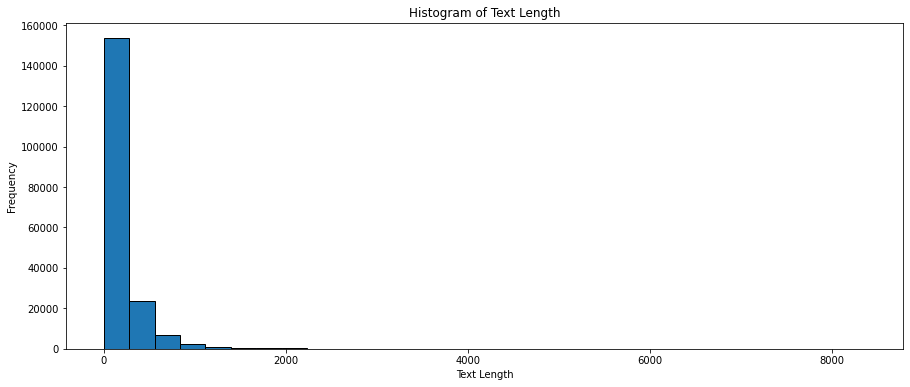

In [ ]:
plt.figure(figsize=(15,6))
plt.hist(df_new['text_length'], bins=30, edgecolor='black')
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.title('Histogram of Text Length')
plt.show()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation as LDA

In [ ]:
text_data = df_new['self_text'].astype(str)

In [ ]:
vectorizer = CountVectorizer(max_df=0.85, stop_words='english')
text_vectorized = vectorizer.fit_transform(text_data)

In [ ]:
num_topics = 5
lda = LDA(n_components=num_topics, random_state=42)
lda.fit(text_vectorized)

LatentDirichletAllocation(n_components=5, random_state=42)

In [ ]:
for topic_idx, topic in enumerate(lda.components_):
    print(f"Topic {topic_idx + 1}:")
    print([vectorizer.get_feature_names()[i] for i in topic.argsort()[:-10 - 1:-1]])
    print()

Topic 1:
['iran', 'just', 'russia', 'israel', 'ukraine', 'like', 'dont', 'going', 'weapons', 'time']

Topic 2:
['hamas', 'israel', 'people', 'gaza', 'civilians', 'palestinians', 'just', 'israeli', 'like', 'war']

Topic 3:
['like', 'just', 'people', 'say', 'video', 'news', 'im', 'post', 'good', 'media']

Topic 4:
['comments', 'action', 'questions', 'comment', 'concerns', 'contact', 'based', 'automatically', 'performed', 'moderators']

Topic 5:
['israel', 'jews', 'land', 'palestine', 'people', 'palestinians', 'arab', 'like', 'jewish', 'state']



In [ ]:
df_new

,comment_id,score,self_text,subreddit,created_time,sentiment,text_length
0,k5480sx,1,exactlycan remember the humanitarian aid strea...,worldnews,2023-10-16 19:39:00,0.000000,278
1,k547q14,1,we are the only part of the world that has fre...,Palestine,2023-10-16 19:36:00,0.000000,148
2,k547elf,1,i don’t make israeli strategy nor amisraeli or...,worldnews,2023-10-16 19:34:00,0.305159,285
3,k54742r,1,these people didnt vote hamas in or something ...,worldnews,2023-10-16 19:32:00,0.045000,630
4,k5473zi,1,we dont care what you do we just want to live ...,worldnews,2023-10-16 19:32:00,-0.347643,293
...,...,...,...,...,...,...,...
189626,k3sdwfc,42,us this is bullshit,Palestine,2023-07-10 05:20:00,0.000000,19
189627,k3sdixt,1,i am in the united states and it has the dotte...,Palestine,2023-07-10 05:17:00,0.000000,120
189628,k3sccp2,54,in which country are you sometimes maps adapt ...,Palestine,2023-07-10 05:08:00,0.000000,123
189629,k3ritvj,116,you cant give up on something you only pretend...,worldnews,2023-07-10 01:46:00,-0.300000,79


In [ ]:
highest_score_index = df_new['score'].idxmax()

lowest_score_index = df_new['score'].idxmin()

highest_score_text = df_new.loc[highest_score_index, 'self_text']
highest_score = df_new.loc[highest_score_index, 'score']

lowest_score_text = df_new.loc[lowest_score_index, 'self_text']
lowest_score = df_new.loc[lowest_score_index, 'score']

print(f"Comment with the highest score ({highest_score}):")
print(highest_score_text)
print("\n")

print(f"Comment with the lowest score ({lowest_score}):")
print(lowest_score_text)

Comment with the highest score (16463):
that’s pretty damning for netanyahu and israeli intelligence no


Comment with the lowest score (-934):
too bad its pretty much pointless when they fire thousands of rockets


In [ ]:
def categorize_sentiment(polarity):
    if polarity > 0.05:
        return 'Positive'
    elif polarity < -0.05:
        return 'Negative'
    else:
        return 'Neutral'

In [ ]:
df_new['sentiment_category'] = df_new['sentiment'].apply(categorize_sentiment)

In [ ]:
df_new

,comment_id,score,self_text,subreddit,created_time,sentiment,text_length,sentiment_category
0,k5480sx,1,exactlycan remember the humanitarian aid strea...,worldnews,2023-10-16 19:39:00,0.000000,278,Neutral
1,k547q14,1,we are the only part of the world that has fre...,Palestine,2023-10-16 19:36:00,0.000000,148,Neutral
2,k547elf,1,i don’t make israeli strategy nor amisraeli or...,worldnews,2023-10-16 19:34:00,0.305159,285,Positive
3,k54742r,1,these people didnt vote hamas in or something ...,worldnews,2023-10-16 19:32:00,0.045000,630,Neutral
4,k5473zi,1,we dont care what you do we just want to live ...,worldnews,2023-10-16 19:32:00,-0.347643,293,Negative
...,...,...,...,...,...,...,...,...
189626,k3sdwfc,42,us this is bullshit,Palestine,2023-07-10 05:20:00,0.000000,19,Neutral
189627,k3sdixt,1,i am in the united states and it has the dotte...,Palestine,2023-07-10 05:17:00,0.000000,120,Neutral
189628,k3sccp2,54,in which country are you sometimes maps adapt ...,Palestine,2023-07-10 05:08:00,0.000000,123,Neutral
189629,k3ritvj,116,you cant give up on something you only pretend...,worldnews,2023-07-10 01:46:00,-0.300000,79,Negative


In [ ]:
df_new['sentiment_category'].unique()

array(['Neutral', 'Positive', 'Negative'], dtype=object)

In [ ]:
df_new['sentiment_category'].value_counts()

Neutral     79689
Positive    68529
Negative    41413
Name: sentiment_category, dtype: int64

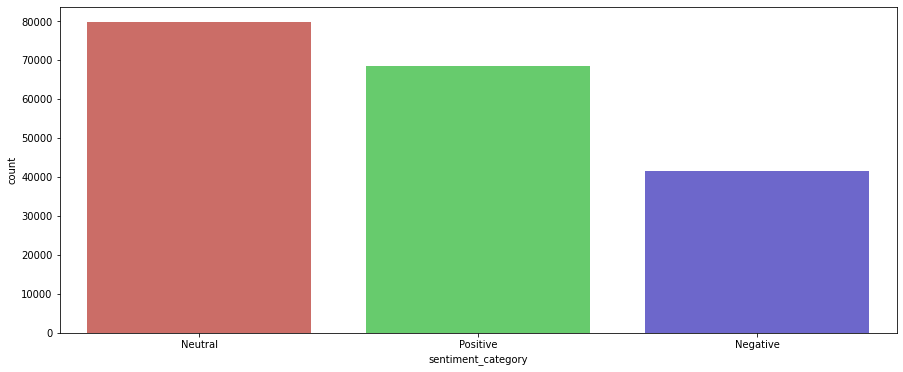

In [ ]:
plt.figure(figsize=(15,6))
sns.countplot(df_new['sentiment_category'], data = df_new, palette = 'hls')
plt.show()

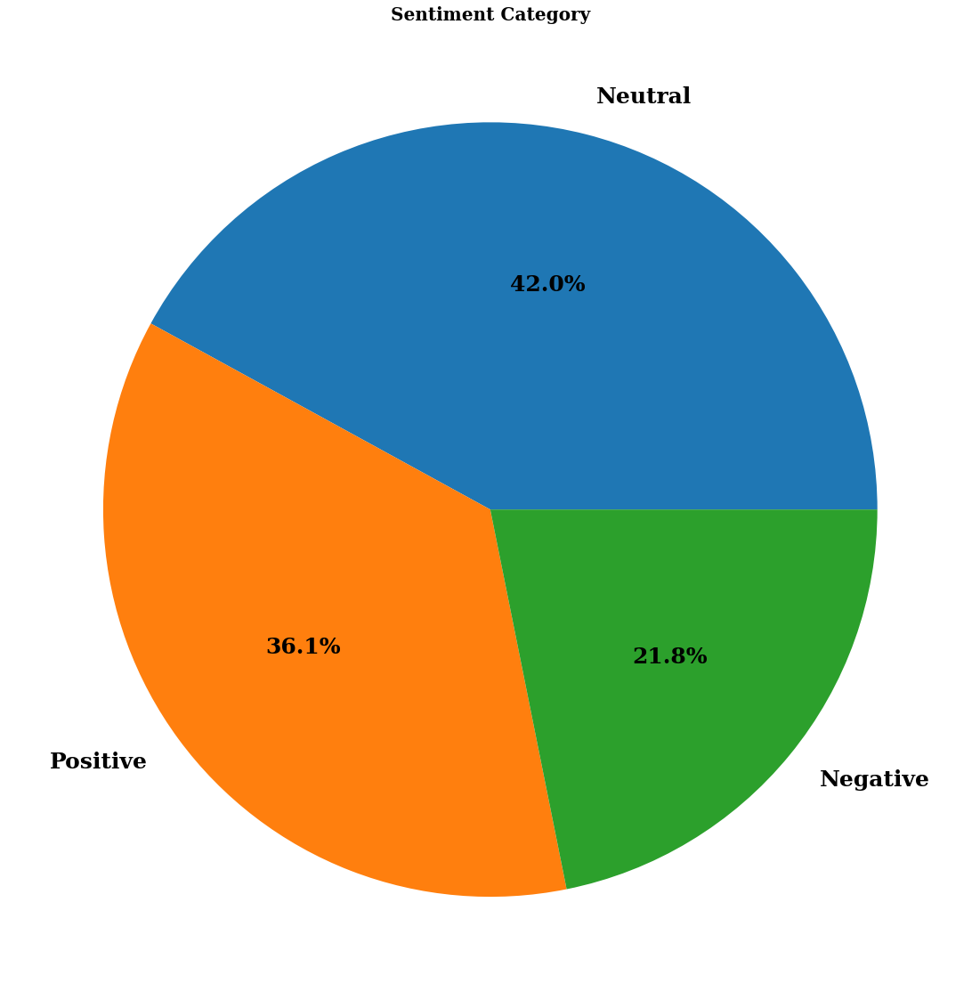

In [ ]:
plt.figure(figsize=(30,20))
plt.pie(df_new['sentiment_category'].value_counts(), labels=df_new['sentiment_category'].value_counts().index,
        autopct='%1.1f%%', textprops={ 'fontsize': 25,
                                       'color': 'black',
                                        'weight': 'bold',
                                        'family': 'serif' })
hfont = {'fontname':'serif', 'weight': 'bold'}
plt.title('Sentiment Category', size=20, **hfont)
plt.show()

In [ ]:
def map_sentiment_to_numeric(sentiment_category):
    if sentiment_category == 'Positive':
        return 1
    elif sentiment_category == 'Negative':
        return -1
    else:
        return 0

In [ ]:
df_new['sentiment_numeric'] = df_new['sentiment_category'].apply(map_sentiment_to_numeric)

In [ ]:
df3 = df_new[['self_text', 'sentiment_numeric']]

In [ ]:
df3

,self_text,sentiment_numeric
0,exactlycan remember the humanitarian aid strea...,0
1,we are the only part of the world that has fre...,0
2,i don’t make israeli strategy nor amisraeli or...,1
3,these people didnt vote hamas in or something ...,0
4,we dont care what you do we just want to live ...,-1
...,...,...
189626,us this is bullshit,0
189627,i am in the united states and it has the dotte...,0
189628,in which country are you sometimes maps adapt ...,0
189629,you cant give up on something you only pretend...,-1


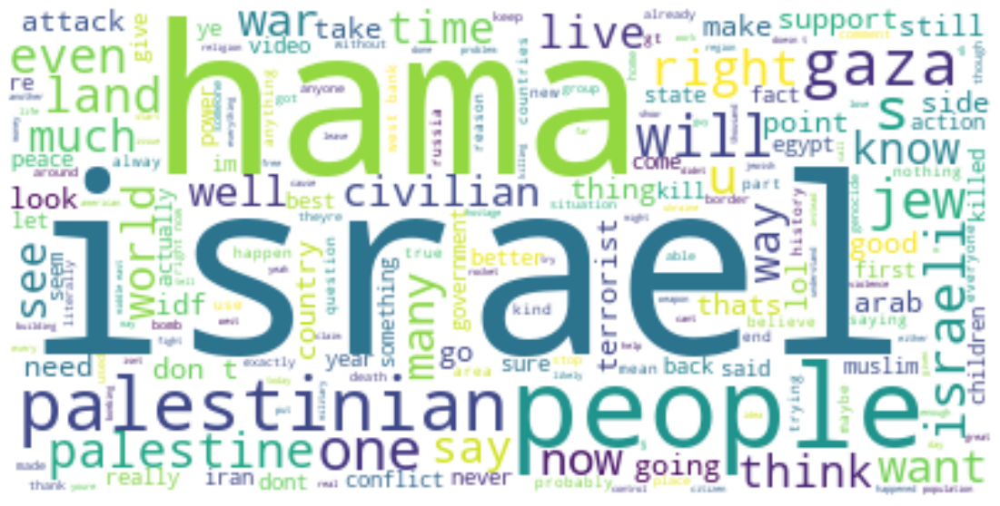

In [ ]:
positive_text_data = ' '.join(df_new[df3['sentiment_numeric'] == 1]['self_text'])

if positive_text_data:
    wordcloud = WordCloud(background_color='white').generate(positive_text_data)

    fig, ax = plt.subplots(figsize=(30, 10))
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.axis('off')
    plt.show()
else:
    print('No positive text data to generate a word cloud.')

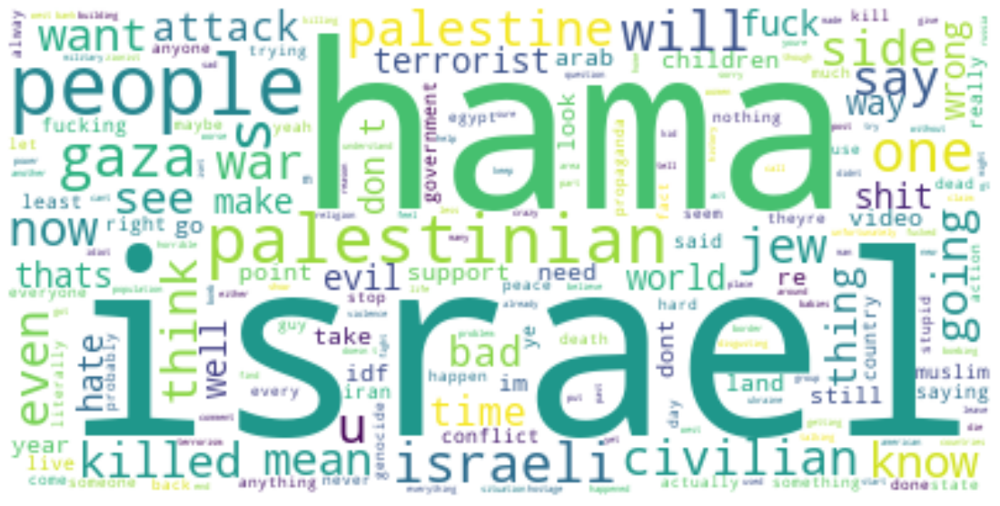

In [ ]:
negative_text_data = ' '.join(df_new[df3['sentiment_numeric'] == -1]['self_text'])

if negative_text_data:
    wordcloud = WordCloud(background_color='white').generate(negative_text_data)

    fig, ax = plt.subplots(figsize=(30, 10))
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.axis('off')
    plt.show()
else:
    print('No negative text data to generate a word cloud.')

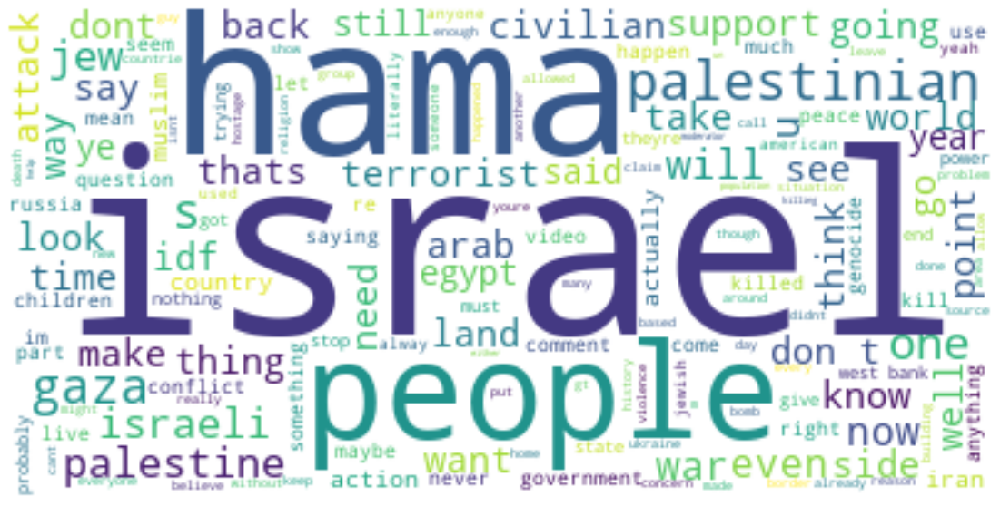

In [ ]:
neutral_text_data = ' '.join(df_new[df3['sentiment_numeric'] == 0]['self_text'])

if neutral_text_data:
    wordcloud = WordCloud(background_color='white').generate(neutral_text_data)

    fig, ax = plt.subplots(figsize=(30, 10))
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.axis('off')
    plt.show()
else:
    print('No neutral text data to generate a word cloud.')

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
from sklearn.metrics import precision_recall_fscore_support
from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
X = df_new['self_text']
y = df_new['sentiment_numeric']

In [ ]:
tfidf_vectorizer = TfidfVectorizer(max_features=5000)
X_tfidf = tfidf_vectorizer.fit_transform(X)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_tfidf, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
lr_classifier = LogisticRegression()
lr_classifier.fit(X_train, y_train)

LogisticRegression()

In [ ]:
y_pred = lr_classifier.predict(X_test)
lr_accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", lr_accuracy)

Accuracy: 0.8297255253513328


In [ ]:
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='weighted')
print('Precision:', precision)
print('Recall:', recall)
print('F1 Score:', f1)

Precision: 0.8311469792237322
Recall: 0.8297255253513328
F1 Score: 0.8291814267939249


In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
dt_classifier = DecisionTreeClassifier()
dt_classifier.fit(X_train, y_train)

DecisionTreeClassifier()

In [ ]:
y_pred = dt_classifier.predict(X_test)
dt_accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", dt_accuracy)

Accuracy: 0.7498615761858307


In [ ]:
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='weighted')
print('Precision:', precision)
print('Recall:', recall)
print('F1 Score:', f1)

Precision: 0.7489914531442408
Recall: 0.7498615761858307
F1 Score: 0.7493180803889777


In [ ]:
accuracies = {
    'Logistic Regression': lr_accuracy,
    'Decision Tree': dt_accuracy,
}

In [ ]:
fig = go.Figure(
    data=[
        go.Bar(x=list(accuracies.keys()), y=list(accuracies.values()))
    ],
    layout={
        'title': 'Model Comparison: Accuracy',
        'xaxis': {'title': 'Models'},
        'yaxis': {'title': 'Accuracy'}
    }
)
fig.show()